<a href="https://colab.research.google.com/github/ekity1002/DL4US_FINAL_WORK/blob/master/train_model2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


# データ読み込み

In [2]:
import sys
import csv
import copy
from tqdm import tqdm
import gc
import pickle

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline

from tqdm import tqdm
import tensorflow as tf
from tensorflow.keras.callbacks import EarlyStopping, LearningRateScheduler, ReduceLROnPlateau, ModelCheckpoint
from tensorflow.keras import backend as K
from tensorflow.keras.layers import Input, Flatten, Lambda
from tensorflow.keras.applications.vgg16 import VGG16
#from tensorflow.keras.applications.xception import Xception
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.layers import Dense, Embedding, LSTM
from tensorflow.keras.layers import Reshape, Activation, concatenate, dot, BatchNormalization, GlobalAveragePooling2D
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
from functools import partial
np.load = partial(np.load, allow_pickle=True)  # monkey patch

SEED=9999


In [0]:
def load_data():
    def load_pickle(path):
        with open(path, 'rb') as handle:
          return pickle.load(handle)

    # 学習データ
    x_train = np.load('/content/drive/My Drive/Colab Notebooks/data/train_img.npz')['arr_0']
    y_train = np.load('/content/drive/My Drive/Colab Notebooks/data/y_train.npy')
    train_tokenizer = load_pickle('/content/drive/My Drive/Colab Notebooks/data/train_tokenizer.pickle')
    # テストデータ
    x_test = np.load('/content/drive/My Drive/Colab Notebooks/data/test_img.npy')
    y_test = np.load('/content/drive/My Drive/Colab Notebooks/data/y_test.npy')
    test_tokenizer = load_pickle('/content/drive/My Drive/Colab Notebooks/data/test_tokenizer.pickle')

    # 長さを最長のリストにそろえる。短いものは0パディング
    y_train = pad_sequences(y_train, padding='post')
    y_test = pad_sequences(y_test, padding='post')

    return (x_train, y_train, train_tokenizer, x_test, y_test, test_tokenizer)

x_train, y_train, train_tokenizer, x_test, y_test, test_tokenizer = load_data()

In [4]:
print(x_train.shape)
print(y_train.shape)
train_tokenizer.index_word

(4000, 224, 224, 3)
(4000, 35)


{1: '醤油',
 2: '塩',
 3: '酒',
 4: '砂糖',
 5: 'みりん',
 6: 'ゴマ油',
 7: 'オリーブオイル',
 8: '塩コショウ',
 9: 'ニンニク',
 10: 'ねぎ',
 11: 'マヨネーズ',
 12: '玉ねぎ',
 13: '黒胡椒',
 14: '片栗粉',
 15: 'サラダ油',
 16: '生姜',
 17: '日本酒',
 18: 'バター',
 19: '卵',
 20: 'キュウリ',
 21: '味噌',
 22: '大根',
 23: 'にんじん',
 24: '酢',
 25: 'こしょう',
 26: '小麦粉',
 27: '揚げ油',
 28: '麺つゆ',
 29: 'じゃがいも',
 30: '大葉',
 31: 'ポン酢',
 32: 'レモン汁',
 33: 'わさび',
 34: 'チューブ生姜',
 35: '鰹節',
 36: 'パセリ',
 37: '刺身',
 38: 'オリーブ油',
 39: 'トマト',
 40: 'とろけるチーズ',
 41: 'チューブニンニク',
 42: 'レモン',
 43: '出汁',
 44: 'ベーコン',
 45: '七味唐辛子',
 46: '鷹の爪',
 47: 'しめじ',
 48: 'ケチャップ',
 49: '白ワイン',
 50: 'ピザ用チーズ',
 51: 'おろしにんにく',
 52: '白ごま',
 53: 'ピーマン',
 54: '薄口醤油',
 55: 'キャベツ',
 56: 'ゴマ',
 57: '牛乳',
 58: 'シイタケ',
 59: '豆腐',
 60: 'おろし生姜',
 61: '青ネギ',
 62: 'こんにゃく',
 63: '粉チーズ',
 64: 'クリームチーズ',
 65: '油揚げ',
 66: 'はちみつ',
 67: '一味唐辛子',
 68: '竹輪',
 69: 'ナス',
 70: 'パン粉',
 71: '鶏ガラスープの素',
 72: '餃子の皮',
 73: 'オイスターソース',
 74: '黒コショウ',
 75: 'ブロッコリー',
 76: '生ハム',
 77: '厚揚げ',
 78: 'チーズ',
 79: '砂肝',
 80: '白菜',

# モデル学習

## モデルの定義

In [5]:
# 色々定義
detokenizer = dict(map(reversed, train_tokenizer.word_index.items()))
vocab_size = len(train_tokenizer.word_index)
print("vocab_size: ",vocab_size)
bos_eos = train_tokenizer.texts_to_sequences(["<s>", "</s>"])

vocab_size:  2045


In [6]:
y_train_ohe = np.zeros((len(y_train), vocab_size))
for i, word_indexes in tqdm(enumerate(y_train)):
    for index in word_indexes:
        #print(index)
        if index != 0:
            y_train_ohe[i, index-1] = 1
print(y_train_ohe.shape)

4000it [00:00, 14565.62it/s]

(4000, 2045)


In [0]:
x_tra, x_val, y_tra, y_val = train_test_split(x_train, y_train_ohe, test_size=0.1, random_state=SEED, shuffle=True)

### CNN+sigmoid マルチラベル分類モデル

In [8]:
# Fine Tune 学習済みモデル
encoder_input = Input(shape=(224, 224, 3))
encoder_input_normalized = Lambda(lambda x: x / 255.)(encoder_input) # [0, 255) -> [0, 1)
encoder = VGG16(weights='imagenet', include_top=False, input_tensor=encoder_input_normalized)# VGG
#encoder = Xception(weights='imagenet', include_top=False, input_tensor=encoder_input_normalized)# Xception

# Fine Tune 用に一部パラメータを固定
for layer in encoder.layers[:15]:
    layer.trainable = False

# CNNの出力
u = Flatten()(encoder.output)
#u = GlobalAveragePooling2D()(encoder.output)
u = Dense(1024, kernel_initializer='he_normal')(u)
u = BatchNormalization()(u)
u = Activation('relu')(u)
u = Dense(512, kernel_initializer='he_normal')(u)
u = BatchNormalization()(u)
u = Activation('relu')(u)
u = Dense(1024, kernel_initializer='he_normal')(u)
u = BatchNormalization()(u)
u = Activation('relu')(u)
out = Dense(vocab_size, activation='sigmoid')(u)
print(out.shape)

Instructions for updating:
If using Keras pass *_constraint arguments to layers.
58892288/58889256 [==============================] - 2s 0us/step
(?, 2045)


In [9]:
# 損失関数
def binary_loss(y_true, y_pred):
    print(y_true.shape)
    bce = K.binary_crossentropy(y_true, y_pred)
    print(bce.shape)
    return K.sum(bce, axis=-1)

# 評価関数
def total_acc(y_true, y_pred):
    pred = K.cast(K.greater_equal(y_pred, 0.5), "float")
    flag = K.cast(K.equal(y_true, pred), "float")
    return K.prod(flag, axis=-1)

def binary_acc(y_true, y_pred):
    pred = K.cast(K.greater_equal(y_pred, 0.5), 'float')
    flag = K.cast(K.equal(y_true, pred), 'float')
    return K.mean(flag, axis=-1)


model = Model(encoder_input, out)
model.compile(loss=binary_loss, optimizer=Adam(), metrics=[total_acc, binary_acc])
#model.compile(loss='binary_crossentropy', optimizer=Adam(), metrics=[total_acc, binary_acc])

(?, ?)
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
(?, 2045)


In [0]:
# from sklearn.utils import class_weight
# class_weights = class_weight.compute_class_weight('balanced',
#                                                  np.unique(y_train),
#                                                  y_train)
# print(y_train.shape)
# np.unique(y_train)

In [0]:

# val1 = K.variable(np.array([[1,0,0,0,1],
#                           [1,0,0,0,1]]))
# val2 =  K.variable(np.array([[0, 1,0,0,0],
#                             [1,0,0,0,1]]))
# result = binary_loss(val1, val2)
# with tf.Session() as sess:
#     sess.run(tf.global_variables_initializer())
#     result = sess.run(result)
#     print(result.shape)

In [0]:
# 水増し用
def train_generator(x, y, batch_size):
    gen_params = {
        'rotation_range':20,
        'horizontal_flip':True,
        'vertical_flip': True,
        'height_shift_range':0.2,
        'width_shift_range':0.2,
        'shear_range': 5,
        'zoom_range':0.2,
        'channel_shift_range':5.,
        #'featurewise_center': True, #データセット全体で画素値平均を0にする
        'samplewise_center': True, #サンプルごとの画素値の平均を0にする
    }
    img_gen = ImageDataGenerator(**gen_params)
    for x_batch, y_batch in img_gen.flow(x,y,batch_size=batch_size):
        yield x_batch, y_batch

def val_generator(x, y, batch_size):
    img_gen = ImageDataGenerator() # 検証用には処理を加えない!!
    for x_batch, y_batch in img_gen.flow(x,y,batch_size=batch_size):
        yield x_batch, y_batch

### モデル図

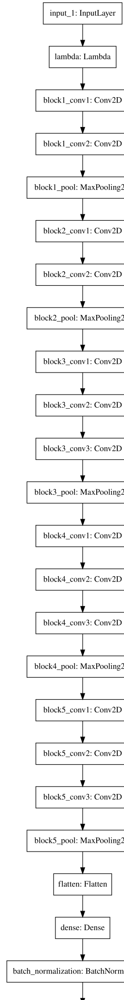

In [13]:
from IPython.display import SVG
from tensorflow.python.keras.utils.vis_utils import model_to_dot

SVG(model_to_dot(model).create(prog='dot', format='svg'))

# 学習

### train_target の内容　要検討

In [14]:
modelpath = '/content/drive/My Drive/Colab Notebooks/data/models/baseline.h5'
callbacks = [
    EarlyStopping(monitor='val_loss', patience=30),
    ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=10),
    ModelCheckpoint(filepath=modelpath, monitor='val_total_acc', save_best_only=True)
]
batch_size=128
epochs = 5000
model.fit_generator(train_generator(x_tra, y_tra, batch_size),
                    steps_per_epoch=len(x_train)//batch_size,
                    epochs=epochs,
                    validation_data=val_generator(x_val, y_val, batch_size),
                    validation_steps=len(x_val)//batch_size,
                    callbacks=callbacks,
                    verbose=2)
# model.fit(x_train, y_train_ohe,
#           batch_size=128, epochs=1000, verbose=1, validation_split=0.1, callbacks=callbacks)

Epoch 1/5000
Epoch 1/5000
31/31 - 46s - loss: 205.3270 - total_acc: 0.0000e+00 - binary_acc: 0.9696 - val_loss: 59.9220 - val_total_acc: 0.0000e+00 - val_binary_acc: 0.9969
Epoch 2/5000
Epoch 1/5000
31/31 - 38s - loss: 32.4235 - total_acc: 0.0000e+00 - binary_acc: 0.9970 - val_loss: 38.4557 - val_total_acc: 0.0000e+00 - val_binary_acc: 0.9969
Epoch 3/5000
Epoch 1/5000
31/31 - 38s - loss: 31.4917 - total_acc: 0.0000e+00 - binary_acc: 0.9970 - val_loss: 40.5629 - val_total_acc: 0.0000e+00 - val_binary_acc: 0.9969
Epoch 4/5000
Epoch 1/5000
31/31 - 38s - loss: 30.9884 - total_acc: 0.0000e+00 - binary_acc: 0.9970 - val_loss: 38.7494 - val_total_acc: 0.0000e+00 - val_binary_acc: 0.9969
Epoch 5/5000
Epoch 1/5000
31/31 - 39s - loss: 30.6854 - total_acc: 0.0000e+00 - binary_acc: 0.9970 - val_loss: 35.5160 - val_total_acc: 0.0000e+00 - val_binary_acc: 0.9969
Epoch 6/5000
Epoch 1/5000
31/31 - 38s - loss: 30.2421 - total_acc: 2.5934e-04 - binary_acc: 0.9970 - val_loss: 34.4826 - val_total_acc: 0.0

In [15]:
model = load_model('/content/drive/My Drive/Colab Notebooks/data/models/baseline.h5',
                   custom_objects={'binary_loss': binary_loss, 'total_acc': total_acc, 'binary_acc': binary_acc})

Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
(?, ?)
(?, 2045)


In [0]:
preds= model.predict(x_test)

[  0   1   2   4   9  30  53 133 148]
['醤油', '塩', '酒', 'みりん', 'ねぎ', 'ポン酢', '薄口醤油', '鶏皮', '白子']


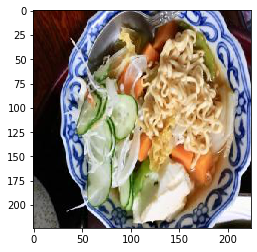

[  1   5   6   7   8  11  12  24  31  34 231 334]
['塩', 'ゴマ油', 'オリーブオイル', '塩コショウ', 'ニンニク', '玉ねぎ', '黒胡椒', 'こしょう', 'レモン汁', '鰹節', 'だし醤油', '生牡蠣']


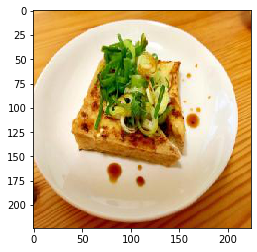

[  0   1   2   3   5   6  12  20  30  51  61  76 133 242]
['醤油', '塩', '酒', '砂糖', 'ゴマ油', 'オリーブオイル', '黒胡椒', '味噌', 'ポン酢', '白ごま', 'こんにゃく', '厚揚げ', '鶏皮', '白味噌']


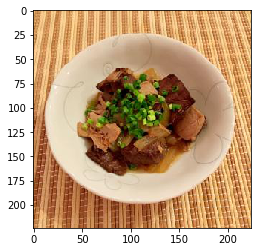

[   0    1    4   27  286  450  504  695  746 1021]
['醤油', '塩', 'みりん', '麺つゆ', 'とろけるスライスチーズ', '濃縮めんつゆ', '揚げ玉', '魚', '絹豆腐', '白炒りごま']


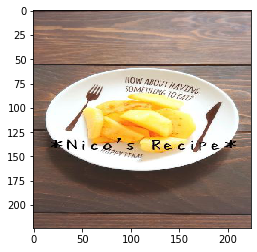

[ 92 237 261]
['イカ', 'みょうが', '塩辛']


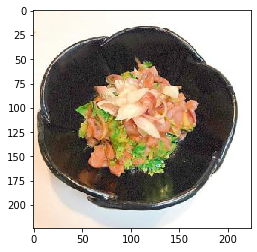

[  0   7   9  11  14  17  33  92 228 295 322 411 554]
['醤油', '塩コショウ', 'ねぎ', '玉ねぎ', 'サラダ油', 'バター', 'チューブ生姜', 'イカ', '醋', '魚肉ソーセージ', 'アオリイカ', 'ヤリイカ', 'モロヘイヤ']


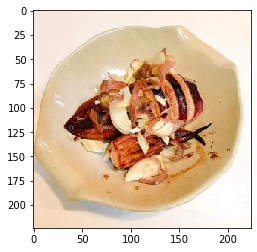

[  1   5  12  16  61  93 132 135 201 890]
['塩', 'ゴマ油', '黒胡椒', '日本酒', 'こんにゃく', 'レンコン', 'なんこつ', '卵黄', '鮭の白子', 'とり肉']


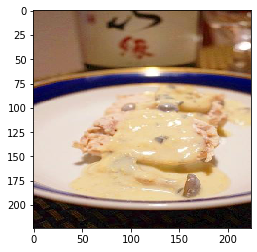

[   0    2    4    6   11   32   53  181  192 1014 1628]
['醤油', '酒', 'みりん', 'オリーブオイル', '玉ねぎ', 'わさび', '薄口醤油', '里芋', 'まぐろ', 'かぼす', 'シーザードレッシング']


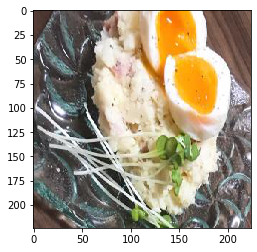

[  0   1   6  10  18  36  91 238 252]
['醤油', '塩', 'オリーブオイル', 'マヨネーズ', '卵', '刺身', '岩塩', '山芋', '小ねぎ']


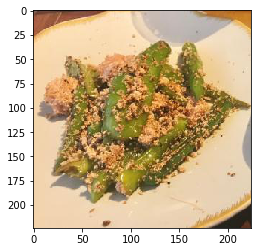

[  0   1   3   7  12  23 457]
['醤油', '塩', '砂糖', '塩コショウ', '黒胡椒', '酢', '根']


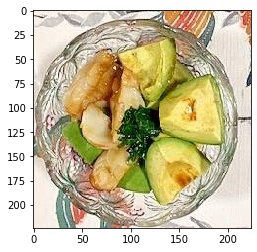

[  0   1   6  33 142]
['醤油', '塩', 'オリーブオイル', 'チューブ生姜', 'かいわれ大根']


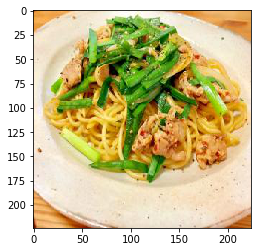

[  0   1   9  55 125 129]
['醤油', '塩', 'ねぎ', 'ゴマ', 'ご飯', '鯵']


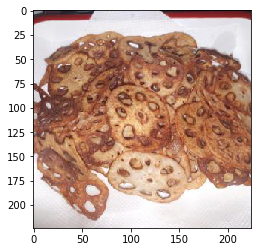

[ 1  3  4 21]
['塩', '砂糖', 'みりん', '大根']


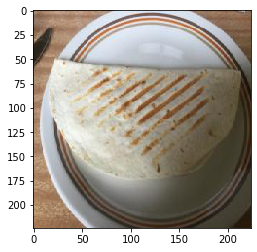

[  1   5   6  10  12  22  25  44  67  93 147 151 206]
['塩', 'ゴマ油', 'オリーブオイル', 'マヨネーズ', '黒胡椒', 'にんじん', '小麦粉', '七味唐辛子', '竹輪', 'レンコン', '豚肉', '青のり', 'すりおろしにんにく']


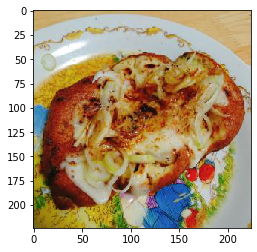

[  0   1  13  40 132 157]
['醤油', '塩', '片栗粉', 'チューブニンニク', 'なんこつ', '粗挽き胡椒']


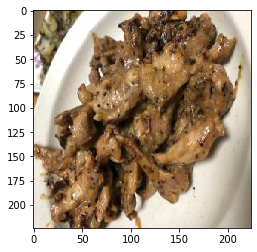

[ 0  1  4 34]
['醤油', '塩', 'みりん', '鰹節']


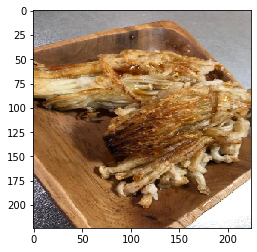

[  0   1   2   4   9  15  33  51  85  98 159 296]
['醤油', '塩', '酒', 'みりん', 'ねぎ', '生姜', 'チューブ生姜', '白ごま', 'ごぼう', '長芋', 'だし', 'イナダ']


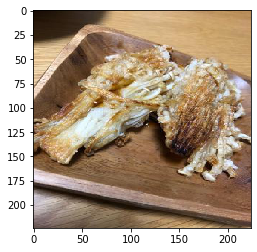

[  1   3  19  22  23  94  95  96 247]
['塩', '砂糖', 'キュウリ', 'にんじん', '酢', '昆布', 'ほうれん草', '和風だし', '本つゆ']


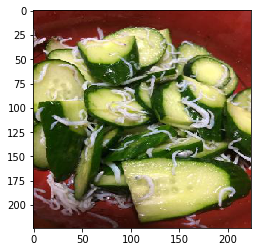

[ 1  3  5 19 30 32]
['塩', '砂糖', 'ゴマ油', 'キュウリ', 'ポン酢', 'わさび']


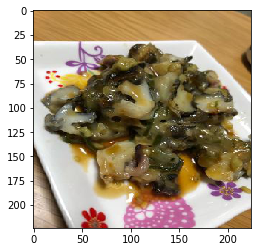

[   0    1    2    3    5    8   13   15   20   34   44   72   80   83
   96  167  276  292  387  724 1181 1182 1183]
['醤油', '塩', '酒', '砂糖', 'ゴマ油', 'ニンニク', '片栗粉', '生姜', '味噌', '鰹節', '七味唐辛子', 'オイスターソース', '牡蠣', '豆板醤', '和風だし', 'おろしショウガ', 'ペースト', '米油', '鹿肉', '花椒', 'ミンチ', '長刀', '豆鼓']


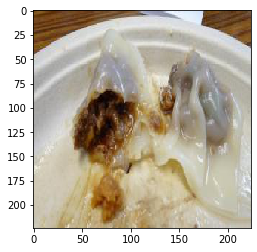

[  1   6   8  10  12  24  28 112 166 232 235]
['塩', 'オリーブオイル', 'ニンニク', 'マヨネーズ', '黒胡椒', 'こしょう', 'じゃがいも', '豚バラ', '豆乳', 'ローズマリー', '粉山椒']


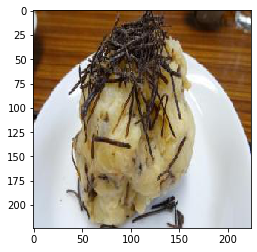

[  0   1   2   5   6   7  11  24  32  36  82 189 600 652]
['醤油', '塩', '酒', 'ゴマ油', 'オリーブオイル', '塩コショウ', '玉ねぎ', 'こしょう', 'わさび', '刺身', 'タコ', 'マグロ', 'にんにくスライス', 'もも肉']


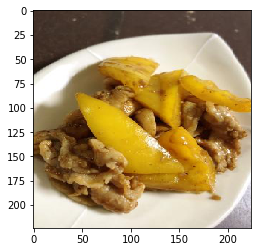

[ 0  1  6  7 11 17 43]
['醤油', '塩', 'オリーブオイル', '塩コショウ', '玉ねぎ', 'バター', 'ベーコン']


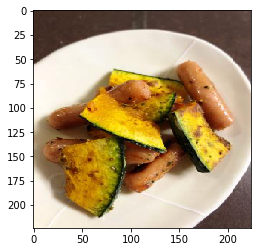

[  1   6  12  24  91 119 236]
['塩', 'オリーブオイル', '黒胡椒', 'こしょう', '岩塩', 'ズッキーニ', 'オリーブ']


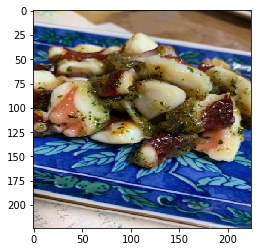

[  0  11  34  76 259 504]
['醤油', '玉ねぎ', '鰹節', '厚揚げ', '太白ごま油', '揚げ玉']


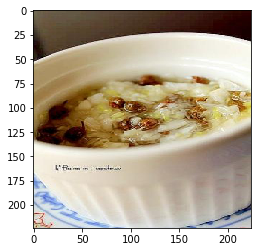

[  0   1   2   4   7  12  13  14  15  18  24  26  69 112 144 185]
['醤油', '塩', '酒', 'みりん', '塩コショウ', '黒胡椒', '片栗粉', 'サラダ油', '生姜', '卵', 'こしょう', '揚げ油', 'パン粉', '豚バラ', 'ガーリックパウダー', '鰯']


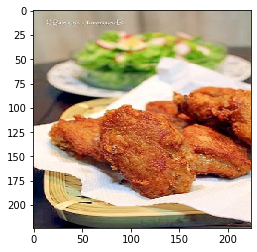

[  1   2   3   4  14  21  22 149]
['塩', '酒', '砂糖', 'みりん', 'サラダ油', '大根', 'にんじん', '赤唐辛子']


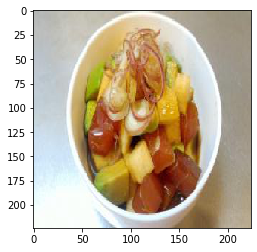

[  0   1   2   4   9  16  41  59 235 431]
['醤油', '塩', '酒', 'みりん', 'ねぎ', '日本酒', 'レモン', 'おろし生姜', '粉山椒', 'さんま']


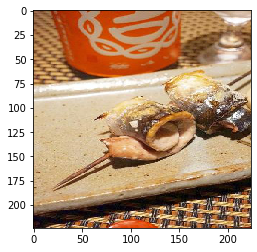

[ 0  1  6  7  9 11 12 17 48]
['醤油', '塩', 'オリーブオイル', '塩コショウ', 'ねぎ', '玉ねぎ', '黒胡椒', 'バター', '白ワイン']


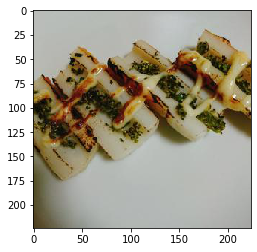

[  0   1   3   4  12  24  51 146 154 186 204 240 311 434]
['醤油', '塩', '砂糖', 'みりん', '黒胡椒', 'こしょう', '白ごま', '味の素', 'おろしニンニク', '鶏レバー', 'すりおろし生姜', '牛肉', 'ベビーリーフ', 'サニーレタス']


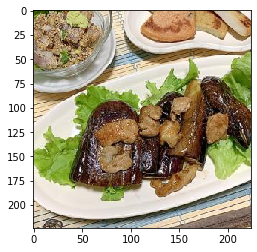

[ 1  2  3  5  6  7 28]
['塩', '酒', '砂糖', 'ゴマ油', 'オリーブオイル', '塩コショウ', 'じゃがいも']


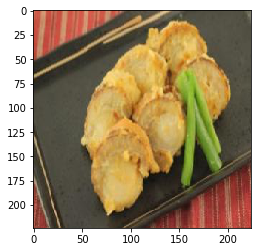

[  0   1   5  36  55  95 277 365]
['醤油', '塩', 'ゴマ油', '刺身', 'ゴマ', 'ほうれん草', '鰹のたたき', '生姜汁']


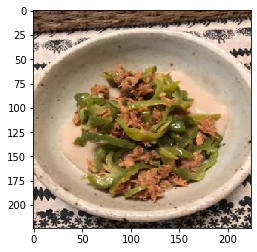

[ 0  1  3 27 94]
['醤油', '塩', '砂糖', '麺つゆ', '昆布']


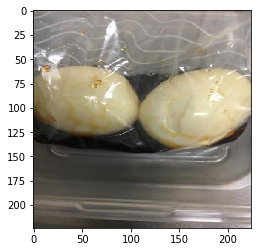

[   0    2    5    6    8   13   34   37  108  174  407 1104]
['醤油', '酒', 'ゴマ油', 'オリーブオイル', 'ニンニク', '片栗粉', '鰹節', 'オリーブ油', '唐辛子', '新玉ねぎ', '小葱', '豚肉の薄切り']


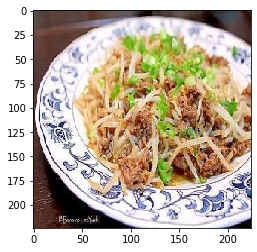

[   0    2    3    5    7   11   27   66   84  223  578  933 1881 1882]
['醤油', '酒', '砂糖', 'ゴマ油', '塩コショウ', '玉ねぎ', '麺つゆ', '一味唐辛子', 'もやし', 'アサリ', '煮干し', '山くらげ', '麻', '婆']


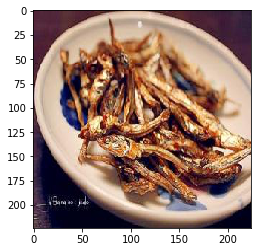

[  0   1  25  37  69  76 231 255 259]
['醤油', '塩', '小麦粉', 'オリーブ油', 'パン粉', '厚揚げ', 'だし醤油', 'タバスコ', '太白ごま油']


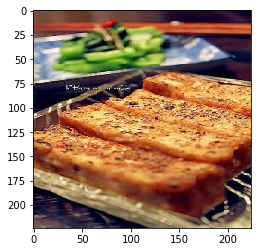

[  1   6   7  10  11  12  17  31  35  41  75  86 161]
['塩', 'オリーブオイル', '塩コショウ', 'マヨネーズ', '玉ねぎ', '黒胡椒', 'バター', 'レモン汁', 'パセリ', 'レモン', '生ハム', 'スライスチーズ', 'クレイジーソルト']


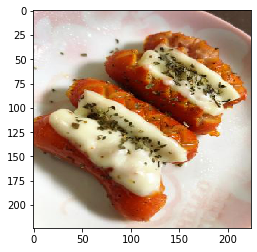

[ 0  5 26 34 83]
['醤油', 'ゴマ油', '揚げ油', '鰹節', '豆板醤']


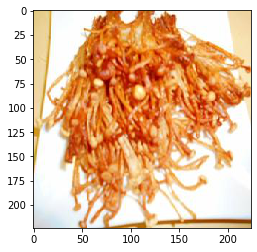

[  0   2   3   4   5   9  11  22  27 103]
['醤油', '酒', '砂糖', 'みりん', 'ゴマ油', 'ねぎ', '玉ねぎ', 'にんじん', '麺つゆ', 'ラー油']


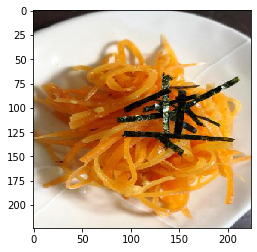

[  0   3  14  20  51 127 130]
['醤油', '砂糖', 'サラダ油', '味噌', '白ごま', 'コチュジャン', '赤ワイン']


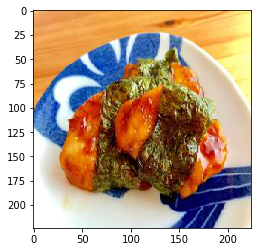

[ 0  1  3  7 11 14 36]
['醤油', '塩', '砂糖', '塩コショウ', '玉ねぎ', 'サラダ油', '刺身']


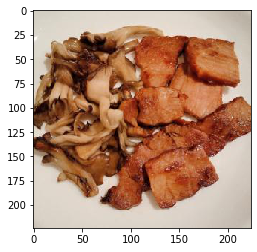

[ 10  11  49 102 114 116 211 294]
['マヨネーズ', '玉ねぎ', 'ピザ用チーズ', 'ツナ', '梅干し', 'ハム', 'ピザ生地', '豆苗']


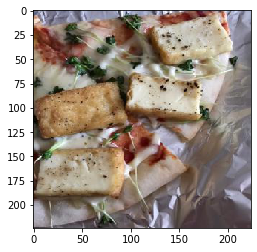

[  0  20  37  40  54  78 118 245 662]
['醤油', '味噌', 'オリーブ油', 'チューブニンニク', 'キャベツ', '砂肝', '酒粕', '銀', '鶏がらスープ']


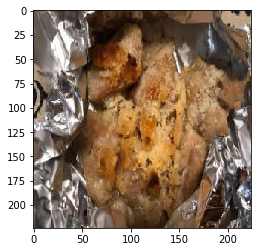

[  0   5   7  17  19  23  29  32  55  90 121]
['醤油', 'ゴマ油', '塩コショウ', 'バター', 'キュウリ', '酢', '大葉', 'わさび', 'ゴマ', 'アボカド', '塩昆布']


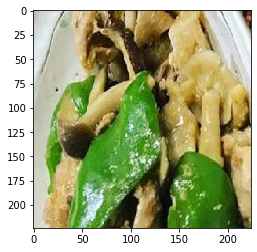

[  1   3   7  13  14  18  26  42  50  59 246 262]
['塩', '砂糖', '塩コショウ', '片栗粉', 'サラダ油', '卵', '揚げ油', '出汁', 'おろしにんにく', 'おろし生姜', '胸肉', '新じゃが']


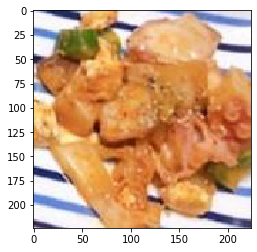

[  0   1   9  33  36  37  78 868]
['醤油', '塩', 'ねぎ', 'チューブ生姜', '刺身', 'オリーブ油', '砂肝', 'ガーリックバター']


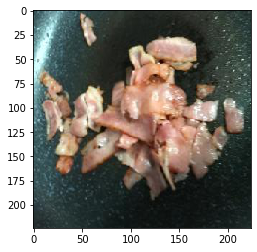

[  0   1   2   4   5  11  22  65 127 191 216]
['醤油', '塩', '酒', 'みりん', 'ゴマ油', '玉ねぎ', 'にんじん', 'はちみつ', 'コチュジャン', '粗塩', '万能ねぎ']


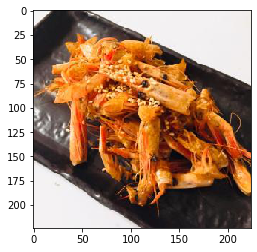

[   0    1    3    4    6   21   27  219  450 1303]
['醤油', '塩', '砂糖', 'みりん', 'オリーブオイル', '大根', '麺つゆ', 'カレー粉', '濃縮めんつゆ', '栗']


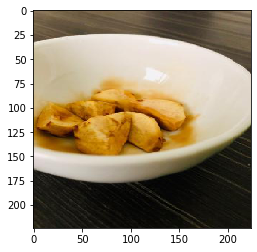

[  0   1   2   4   7  13  40  53 135]
['醤油', '塩', '酒', 'みりん', '塩コショウ', '片栗粉', 'チューブニンニク', '薄口醤油', '卵黄']


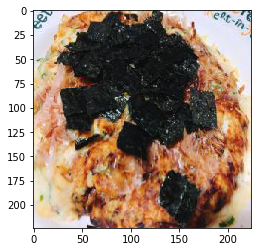

[  0   1   2   4   7  13  24  25  26  41  59  82  88 113 154 170]
['醤油', '塩', '酒', 'みりん', '塩コショウ', '片栗粉', 'こしょう', '小麦粉', '揚げ油', 'レモン', 'おろし生姜', 'タコ', '鶏もも肉', 'チューブ', 'おろしニンニク', 'すり']


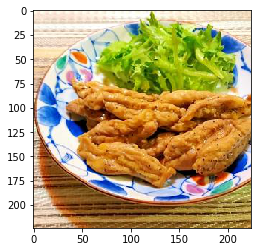

[  0   7  11  14  92 295 363]
['醤油', '塩コショウ', '玉ねぎ', 'サラダ油', 'イカ', '魚肉ソーセージ', 'ガラムマサラ']


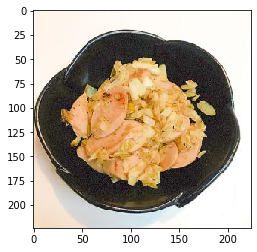

[ 27  29  35  36  81 153 228 261 277 554]
['麺つゆ', '大葉', 'パセリ', '刺身', 'パクチー', 'たまり醤油', '醋', '塩辛', '鰹のたたき', 'モロヘイヤ']


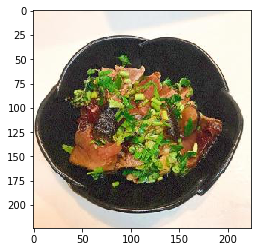

[  0   4   9  13  20  79 132]
['醤油', 'みりん', 'ねぎ', '片栗粉', '味噌', '白菜', 'なんこつ']


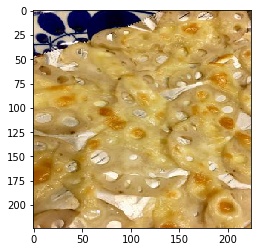

[ 0  1 12 14]
['醤油', '塩', '黒胡椒', 'サラダ油']


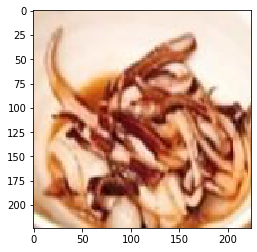

[  0   9  14  36  86  87  92 237 295 427]
['醤油', 'ねぎ', 'サラダ油', '刺身', 'スライスチーズ', 'ムツ', 'イカ', 'みょうが', '魚肉ソーセージ', '紫玉ねぎ']


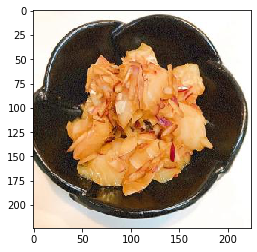

[  0   9  14  23  27  33 153 228 411 554]
['醤油', 'ねぎ', 'サラダ油', '酢', '麺つゆ', 'チューブ生姜', 'たまり醤油', '醋', 'ヤリイカ', 'モロヘイヤ']


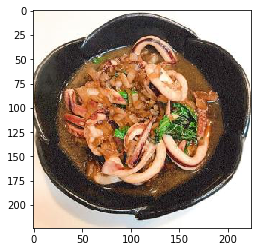

[  0   1   2  10  12  16  20  21  72 101 139 163 437]
['醤油', '塩', '酒', 'マヨネーズ', '黒胡椒', '日本酒', '味噌', '大根', 'オイスターソース', 'ホタテ', '水菜', '河豚', '生春巻きの皮']


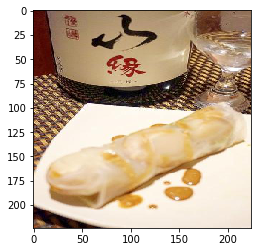

[ 1  3  7 10 27]
['塩', '砂糖', '塩コショウ', 'マヨネーズ', '麺つゆ']


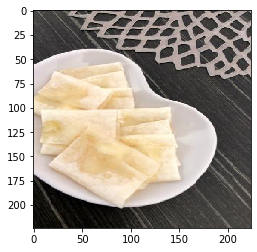

[   1    6    7   10   25   26   35   89  150  307  438 1205]
['塩', 'オリーブオイル', '塩コショウ', 'マヨネーズ', '小麦粉', '揚げ油', 'パセリ', 'パスタ', '天ぷら粉', 'コーン', 'ブルーチーズ', '鮒ずし']


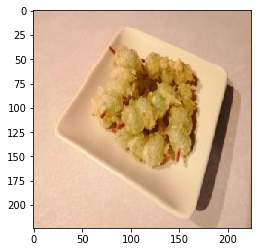

[ 1  5 19 27 55 70 95]
['塩', 'ゴマ油', 'キュウリ', '麺つゆ', 'ゴマ', '鶏ガラスープの素', 'ほうれん草']


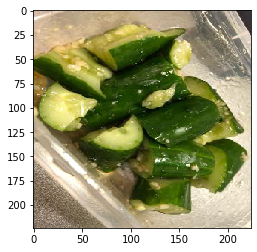

[  1   6   7  44  89 197]
['塩', 'オリーブオイル', '塩コショウ', '七味唐辛子', 'パスタ', 'ベビーチーズ']


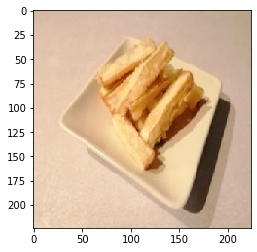

[ 0  5 11 27 52]
['醤油', 'ゴマ油', '玉ねぎ', '麺つゆ', 'ピーマン']


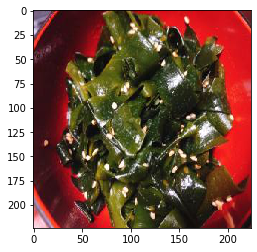

[  0   3   4  19  20 192]
['醤油', '砂糖', 'みりん', 'キュウリ', '味噌', 'まぐろ']


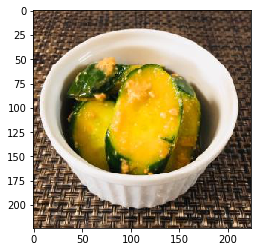

[  0   1   2   5   8   9  12  31  78 103 105 170 196 231 334]
['醤油', '塩', '酒', 'ゴマ油', 'ニンニク', 'ねぎ', '黒胡椒', 'レモン汁', '砂肝', 'ラー油', 'すりごま', 'すり', 'ささみ', 'だし醤油', '生牡蠣']


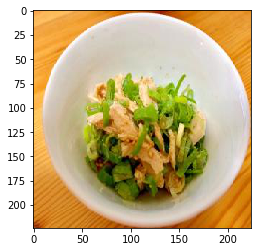

[  0   1   3   5   7  17  19  23  67 352]
['醤油', '塩', '砂糖', 'ゴマ油', '塩コショウ', 'バター', 'キュウリ', '酢', '竹輪', '舞茸']


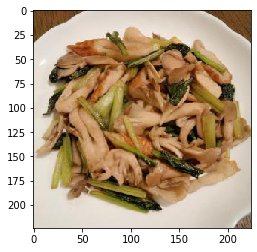

[  0   1   3   4   5   6   7   9  22  33  40  70 129]
['醤油', '塩', '砂糖', 'みりん', 'ゴマ油', 'オリーブオイル', '塩コショウ', 'ねぎ', 'にんじん', 'チューブ生姜', 'チューブニンニク', '鶏ガラスープの素', '鯵']


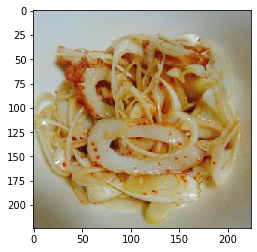

[  0  33 142]
['醤油', 'チューブ生姜', 'かいわれ大根']


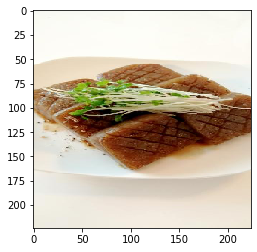

[  0   2   3   4  14  15  17  20 487]
['醤油', '酒', '砂糖', 'みりん', 'サラダ油', '生姜', 'バター', '味噌', '豚ロース']


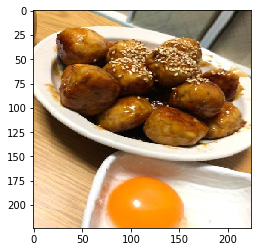

[  6   7  10  11  13  27  28  86 120 207 630 894 895 896]
['オリーブオイル', '塩コショウ', 'マヨネーズ', '玉ねぎ', '片栗粉', '麺つゆ', 'じゃがいも', 'スライスチーズ', '青じそ', 'かぼちゃ', 'モロッコインゲン', 'キス', 'フリッター', '藻塩']


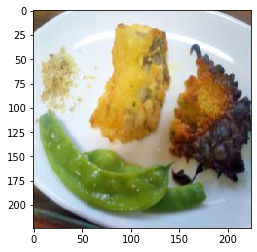

[  0   3   4  16  23  27  32 120 134 136 251 416 894 935]
['醤油', '砂糖', 'みりん', '日本酒', '酢', '麺つゆ', 'わさび', '青じそ', '鮭', '長葱', 'ししとう', 'あん肝', 'キス', '自訴']


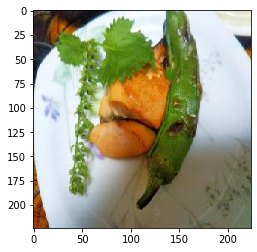

[  0   3   4  32  36 135 192 225 841]
['醤油', '砂糖', 'みりん', 'わさび', '刺身', '卵黄', 'まぐろ', 'サーモン', '柚子こしょう']


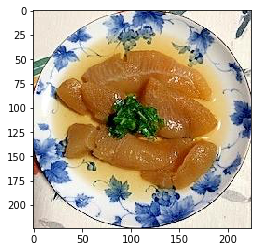

[   0    2    3    4    6    7   11   13   14   15   18   69  100  210
  243  746 1948]
['醤油', '酒', '砂糖', 'みりん', 'オリーブオイル', '塩コショウ', '玉ねぎ', '片栗粉', 'サラダ油', '生姜', '卵', 'パン粉', '炒りごま', '鶏ひき肉', '白いりごま', '絹豆腐', '干ししいたけ']


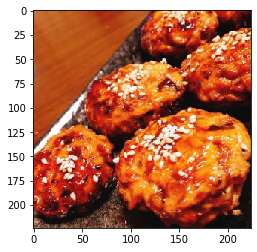

[ 0  1  2  3  5  6  9 27 93 96]
['醤油', '塩', '酒', '砂糖', 'ゴマ油', 'オリーブオイル', 'ねぎ', '麺つゆ', 'レンコン', '和風だし']


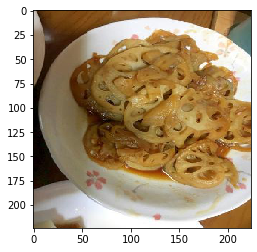

[  7  11  17  39  64 309 536 956]
['塩コショウ', '玉ねぎ', 'バター', 'とろけるチーズ', '油揚げ', '味付け', '切り餅', '稲荷寿司']


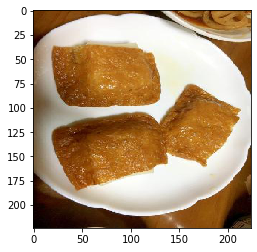

[ 0  1  2  3  4  6 15 36 51 60]
['醤油', '塩', '酒', '砂糖', 'みりん', 'オリーブオイル', '生姜', '刺身', '白ごま', '青ネギ']


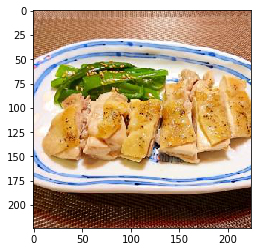

[  1   3   6   7   8  10  11  12  20  31  35  38  48  75  86  90 115 175
 207]
['塩', '砂糖', 'オリーブオイル', '塩コショウ', 'ニンニク', 'マヨネーズ', '玉ねぎ', '黒胡椒', '味噌', 'レモン汁', 'パセリ', 'トマト', '白ワイン', '生ハム', 'スライスチーズ', 'アボカド', 'レタス', 'ゆで卵', 'かぼちゃ']


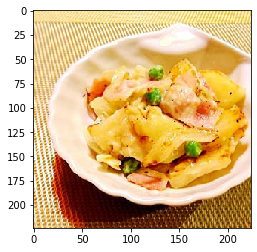

[   0    1    2    3    4    7   14   17   52   59  220  406 1185]
['醤油', '塩', '酒', '砂糖', 'みりん', '塩コショウ', 'サラダ油', 'バター', 'ピーマン', 'おろし生姜', 'しそ', 'カレイ', 'ポッカレモン']


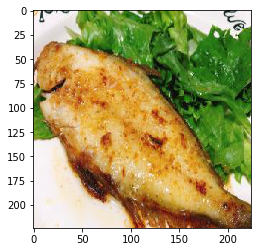

[  1   3   4   6  14  85 178]
['塩', '砂糖', 'みりん', 'オリーブオイル', 'サラダ油', 'ごぼう', '強力粉']


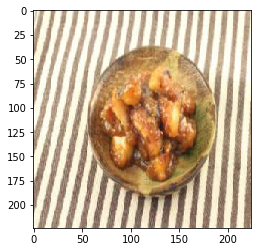

[  0   1   2   3   4   7   8  13  14  18  25  26 172 412]
['醤油', '塩', '酒', '砂糖', 'みりん', '塩コショウ', 'ニンニク', '片栗粉', 'サラダ油', '卵', '小麦粉', '揚げ油', '手羽先', 'しょうがチューブ']


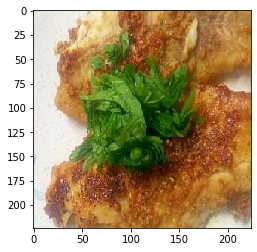

[ 0  5 14 19 30 34 55 76]
['醤油', 'ゴマ油', 'サラダ油', 'キュウリ', 'ポン酢', '鰹節', 'ゴマ', '厚揚げ']


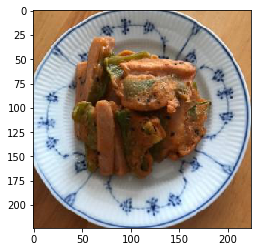

[ 0  1  2  4 14 15 30]
['醤油', '塩', '酒', 'みりん', 'サラダ油', '生姜', 'ポン酢']


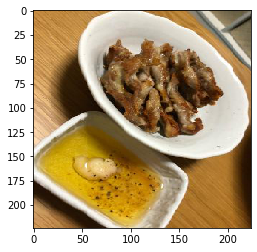

[  0   1   6  30  36 485]
['醤油', '塩', 'オリーブオイル', 'ポン酢', '刺身', '豚ばら肉']


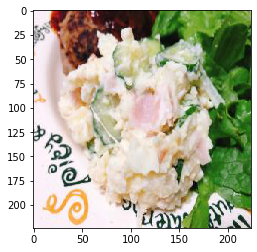

[  0   1   6   7   8  11  12  24  28  40  48  62 264]
['醤油', '塩', 'オリーブオイル', '塩コショウ', 'ニンニク', '玉ねぎ', '黒胡椒', 'こしょう', 'じゃがいも', 'チューブニンニク', '白ワイン', '粉チーズ', 'むきえび']


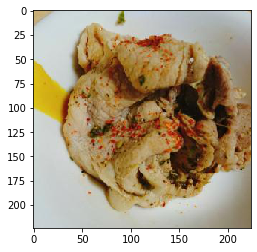

[1]
['塩']


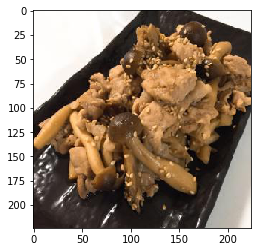

[  0   1   6  10  11  12  17 130 188]
['醤油', '塩', 'オリーブオイル', 'マヨネーズ', '玉ねぎ', '黒胡椒', 'バター', '赤ワイン', 'マスタード']


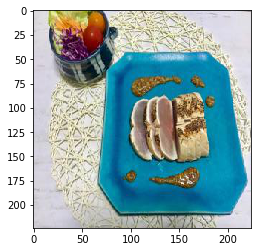

[ 0  1  6  8 10 12 15 27 28 31]
['醤油', '塩', 'オリーブオイル', 'ニンニク', 'マヨネーズ', '黒胡椒', '生姜', '麺つゆ', 'じゃがいも', 'レモン汁']


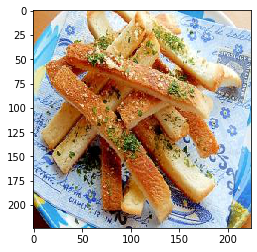

[  1   6  12  21  24  27  32  36 232 296]
['塩', 'オリーブオイル', '黒胡椒', '大根', 'こしょう', '麺つゆ', 'わさび', '刺身', 'ローズマリー', 'イナダ']


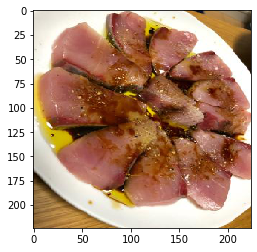

[  0   6   7  10  28  63 882]
['醤油', 'オリーブオイル', '塩コショウ', 'マヨネーズ', 'じゃがいも', 'クリームチーズ', 'アンチョビペースト']


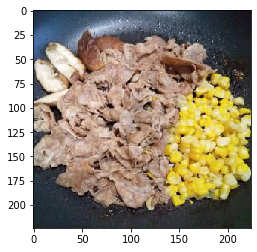

[  1  10  12  17  47  49  63  71  90 207 286 572 599]
['塩', 'マヨネーズ', '黒胡椒', 'バター', 'ケチャップ', 'ピザ用チーズ', 'クリームチーズ', '餃子の皮', 'アボカド', 'かぼちゃ', 'とろけるスライスチーズ', 'いぶりがっこ', '粗挽きコショウ']


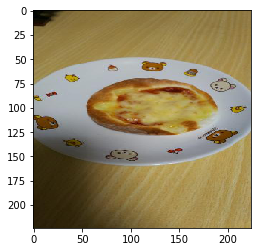

[  0   1   6   9  23  30  46 103 120 295 365]
['醤油', '塩', 'オリーブオイル', 'ねぎ', '酢', 'ポン酢', 'しめじ', 'ラー油', '青じそ', '魚肉ソーセージ', '生姜汁']


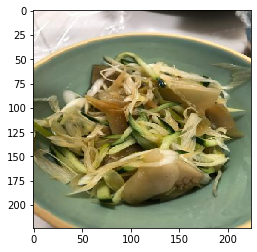

[  0   1   2   7  13  24  25  41  50  53  59  82  88 113 154 199 267 356
 357 430 549 595]
['醤油', '塩', '酒', '塩コショウ', '片栗粉', 'こしょう', '小麦粉', 'レモン', 'おろしにんにく', '薄口醤油', 'おろし生姜', 'タコ', '鶏もも肉', 'チューブ', 'おろしニンニク', 'ライム', '青海苔', '揚げ', 'サラダオイル', 'コーンスターチ', 'げそ', '小エビ']


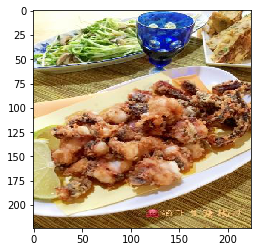

[ 0  1  6 10 31 76 90 98]
['醤油', '塩', 'オリーブオイル', 'マヨネーズ', 'レモン汁', '厚揚げ', 'アボカド', '長芋']


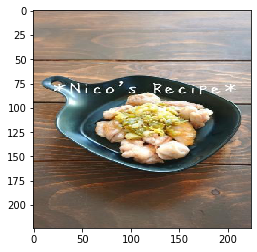

[ 0  1  3  4  5  9 22 27 97]
['醤油', '塩', '砂糖', 'みりん', 'ゴマ油', 'ねぎ', 'にんじん', '麺つゆ', '料理酒']


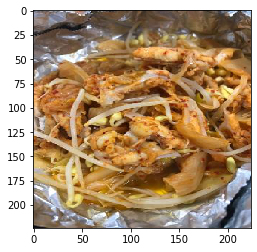

[  1   3   5  20  50 482]
['塩', '砂糖', 'ゴマ油', '味噌', 'おろしにんにく', '鯛のあら']


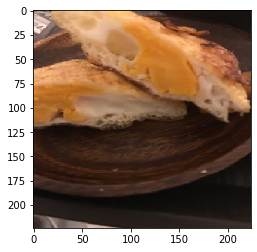

[  0   1   2   4   5  30  42 424]
['醤油', '塩', '酒', 'みりん', 'ゴマ油', 'ポン酢', '出汁', 'すりおろしニンニク']


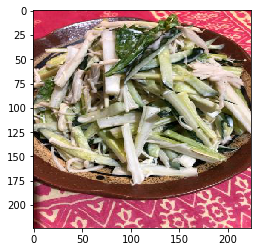

[  0   2   3   4   8  11  19  27  34  50 100 105 300]
['醤油', '酒', '砂糖', 'みりん', 'ニンニク', '玉ねぎ', 'キュウリ', '麺つゆ', '鰹節', 'おろしにんにく', '炒りごま', 'すりごま', '小ネギ']


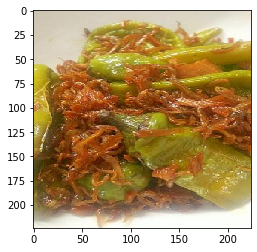

[  0   2   3   4   5   7   8   9  15  17  19  42  55 100 309]
['醤油', '酒', '砂糖', 'みりん', 'ゴマ油', '塩コショウ', 'ニンニク', 'ねぎ', '生姜', 'バター', 'キュウリ', '出汁', 'ゴマ', '炒りごま', '味付け']


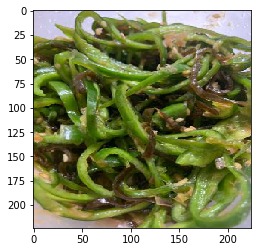

[  0   1   5  24  36  53  78  92 252]
['醤油', '塩', 'ゴマ油', 'こしょう', '刺身', '薄口醤油', '砂肝', 'イカ', '小ねぎ']


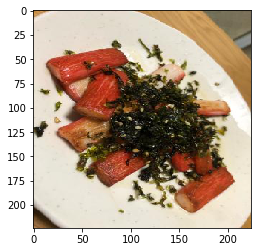

[  0   1   2   4  14  16  30  32  33  36  51  80 296]
['醤油', '塩', '酒', 'みりん', 'サラダ油', '日本酒', 'ポン酢', 'わさび', 'チューブ生姜', '刺身', '白ごま', '牡蠣', 'イナダ']


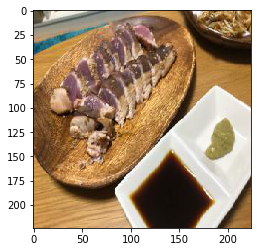

[ 0  3  7 13 28 37 40 62 88]
['醤油', '砂糖', '塩コショウ', '片栗粉', 'じゃがいも', 'オリーブ油', 'チューブニンニク', '粉チーズ', '鶏もも肉']


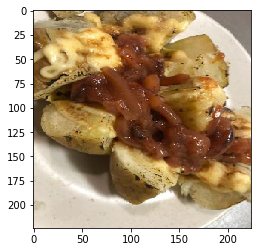

[ 0  1 25 40]
['醤油', '塩', '小麦粉', 'チューブニンニク']


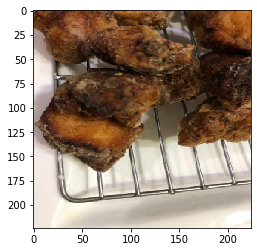

[  1  27  53 149]
['塩', '麺つゆ', '薄口醤油', '赤唐辛子']


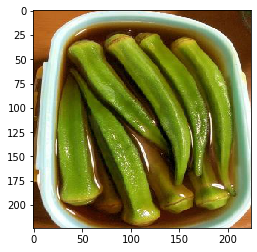

[ 0 36 55]
['醤油', '刺身', 'ゴマ']


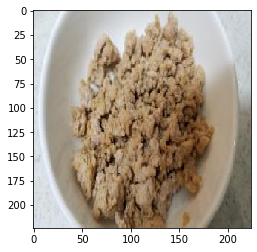

[  0   1   6  10  11  21  27  58  75 120 197 214 617]
['醤油', '塩', 'オリーブオイル', 'マヨネーズ', '玉ねぎ', '大根', '麺つゆ', '豆腐', '生ハム', '青じそ', 'ベビーチーズ', 'バケット', 'グリーンリーフ']


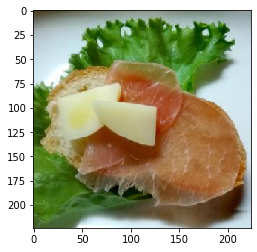

[  1   6   7  10  11  35  86 176 197 214]
['塩', 'オリーブオイル', '塩コショウ', 'マヨネーズ', '玉ねぎ', 'パセリ', 'スライスチーズ', 'ソーセージ', 'ベビーチーズ', 'バケット']


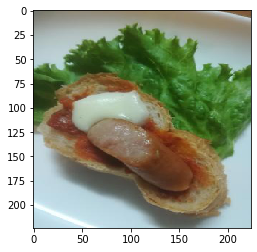

[  1   6   8  11  17 138 189]
['塩', 'オリーブオイル', 'ニンニク', '玉ねぎ', 'バター', 'エビ', 'マグロ']


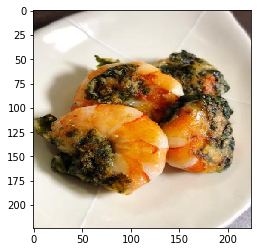

[   5    8   19   66   92   97  348  736 1275 1276]
['ゴマ油', 'ニンニク', 'キュウリ', '一味唐辛子', 'イカ', '料理酒', 'アスパラガス', '穀物酢', '昆布つゆ', 'みりん風調味料']


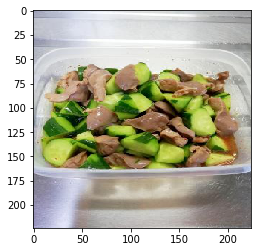

[  1 266]
['塩', '落花生']


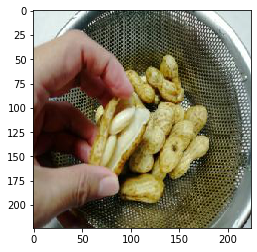

[  1   2   3   9  11  20  21  22  61 232 738]
['塩', '酒', '砂糖', 'ねぎ', '玉ねぎ', '味噌', '大根', 'にんじん', 'こんにゃく', 'ローズマリー', '氷水']


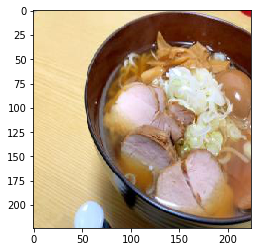

[  7  10  14  26  29  47  86 131 208 269 308 505 657]
['塩コショウ', 'マヨネーズ', 'サラダ油', '揚げ油', '大葉', 'ケチャップ', 'スライスチーズ', 'ウインナー', 'アスパラ', '春巻きの皮', '溶き卵', '春巻の皮', '冷凍パイシート']


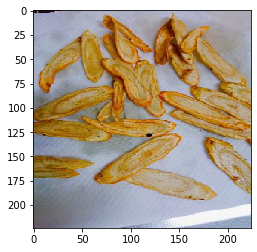

[  0   9  14  23  33  67  92 153 228 261 295 411 554]
['醤油', 'ねぎ', 'サラダ油', '酢', 'チューブ生姜', '竹輪', 'イカ', 'たまり醤油', '醋', '塩辛', '魚肉ソーセージ', 'ヤリイカ', 'モロヘイヤ']


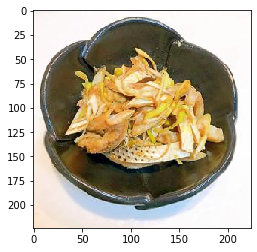

[  0   1   2   3   4   5   7   9  11  22  23  45  64  72 491]
['醤油', '塩', '酒', '砂糖', 'みりん', 'ゴマ油', '塩コショウ', 'ねぎ', '玉ねぎ', 'にんじん', '酢', '鷹の爪', '油揚げ', 'オイスターソース', '豚こま肉']


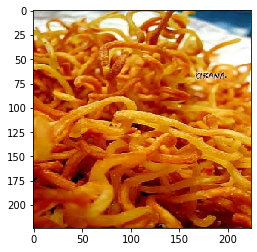

[  0   1   2   4   5   6   7  30  31  32  33  97 460]
['醤油', '塩', '酒', 'みりん', 'ゴマ油', 'オリーブオイル', '塩コショウ', 'ポン酢', 'レモン汁', 'わさび', 'チューブ生姜', '料理酒', '菜']


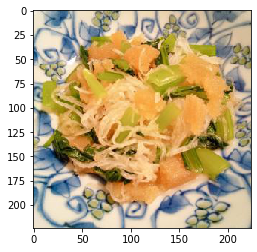

[  0   1  29  30  36  87  91 201 252 380]
['醤油', '塩', '大葉', 'ポン酢', '刺身', 'ムツ', '岩塩', '鮭の白子', '小ねぎ', 'もみじおろし']


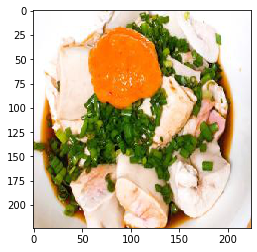

[   0    1    4   32   36  107  192  225  841 1097]
['醤油', '塩', 'みりん', 'わさび', '刺身', '枝豆', 'まぐろ', 'サーモン', '柚子こしょう', 'おかひじき']


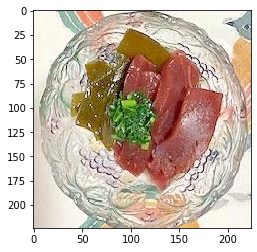

[ 1  3 20 21 27 94]
['塩', '砂糖', '味噌', '大根', '麺つゆ', '昆布']


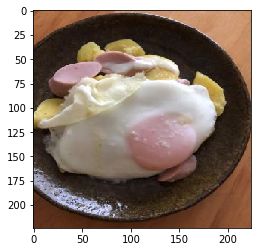

[ 1  2  6  8 20 28 44 63]
['塩', '酒', 'オリーブオイル', 'ニンニク', '味噌', 'じゃがいも', '七味唐辛子', 'クリームチーズ']


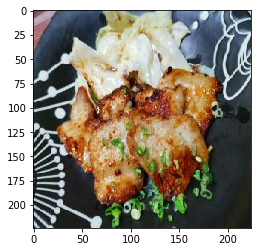

[1 4 5]
['塩', 'みりん', 'ゴマ油']


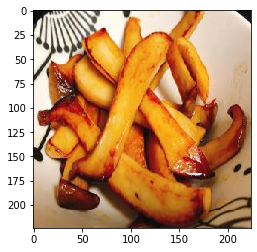

[  0   3   4   5  17  34  57 251 740]
['醤油', '砂糖', 'みりん', 'ゴマ油', 'バター', '鰹節', 'シイタケ', 'ししとう', '万願寺唐辛子']


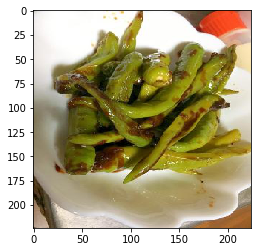

[  1   7  10  14  25  77 702]
['塩', '塩コショウ', 'マヨネーズ', 'サラダ油', '小麦粉', 'チーズ', '豚ローススライス']


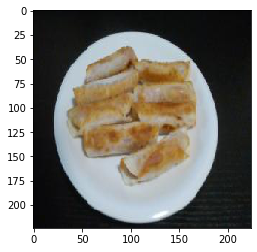

[  1   3  19  22  23  50  95 247 876]
['塩', '砂糖', 'キュウリ', 'にんじん', '酢', 'おろしにんにく', 'ほうれん草', '本つゆ', 'エクストラバージンオイル']


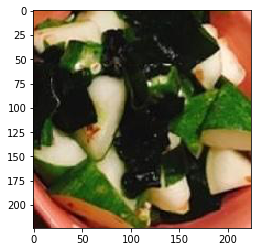

[  1  10  26  49 266]
['塩', 'マヨネーズ', '揚げ油', 'ピザ用チーズ', '落花生']


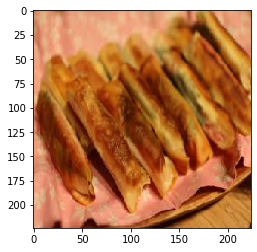

[  0   3   4   5  21  55  61 240]
['醤油', '砂糖', 'みりん', 'ゴマ油', '大根', 'ゴマ', 'こんにゃく', '牛肉']


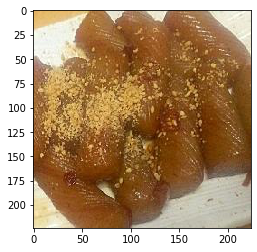

[  1   6   7  12  14  17  28  47  56  75 126 157 162 180 221 358 402 543]
['塩', 'オリーブオイル', '塩コショウ', '黒胡椒', 'サラダ油', 'バター', 'じゃがいも', 'ケチャップ', '牛乳', '生ハム', '月桂樹', '粗挽き胡椒', 'バジル', 'モッツァレラチーズ', 'バゲット', 'ロースハム', '粉末', 'キウイ']


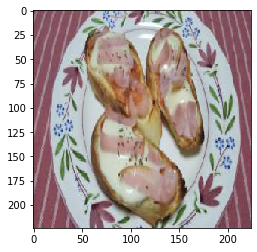

[ 14  17  33  36 153 228 295 322]
['サラダ油', 'バター', 'チューブ生姜', '刺身', 'たまり醤油', '醋', '魚肉ソーセージ', 'アオリイカ']


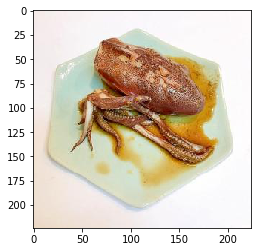

[  1   3   6   7   8  11  13  14  37  47  62  69 126]
['塩', '砂糖', 'オリーブオイル', '塩コショウ', 'ニンニク', '玉ねぎ', '片栗粉', 'サラダ油', 'オリーブ油', 'ケチャップ', '粉チーズ', 'パン粉', '月桂樹']


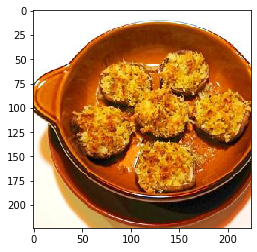

[   1   11   14   18   19   22   27   59   68  140  220  434  526  803
 1277]
['塩', '玉ねぎ', 'サラダ油', '卵', 'キュウリ', 'にんじん', '麺つゆ', 'おろし生姜', 'ナス', '焼肉のたれ', 'しそ', 'サニーレタス', 'あいびき肉', 'フレーク', '韓国のり']


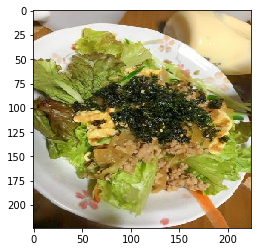

[  1   5  93 151]
['塩', 'ゴマ油', 'レンコン', '青のり']


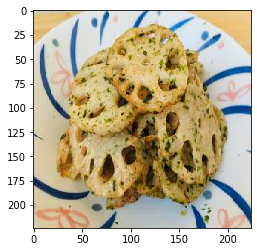

[  0   7  13  14  18  20  40  50  88 132 157]
['醤油', '塩コショウ', '片栗粉', 'サラダ油', '卵', '味噌', 'チューブニンニク', 'おろしにんにく', '鶏もも肉', 'なんこつ', '粗挽き胡椒']


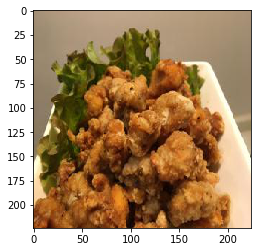

[  0   1  10  13  26  50  93 151 157]
['醤油', '塩', 'マヨネーズ', '片栗粉', '揚げ油', 'おろしにんにく', 'レンコン', '青のり', '粗挽き胡椒']


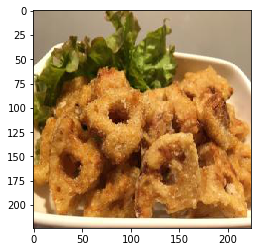

[  0   5   6   8   9  12  27  32  34  70  84 100 105 314 937]
['醤油', 'ゴマ油', 'オリーブオイル', 'ニンニク', 'ねぎ', '黒胡椒', '麺つゆ', 'わさび', '鰹節', '鶏ガラスープの素', 'もやし', '炒りごま', 'すりごま', '葉', '小口ネギ']


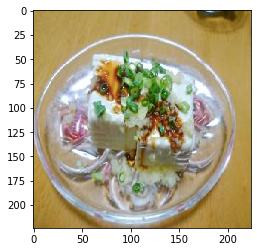

[  0   1   5   7  27  52  55 100 105]
['醤油', '塩', 'ゴマ油', '塩コショウ', '麺つゆ', 'ピーマン', 'ゴマ', '炒りごま', 'すりごま']


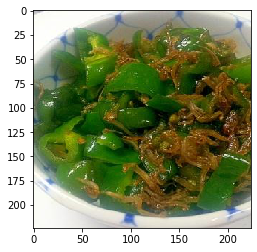

[ 5  7 42 50 70 84 96]
['ゴマ油', '塩コショウ', '出汁', 'おろしにんにく', '鶏ガラスープの素', 'もやし', '和風だし']


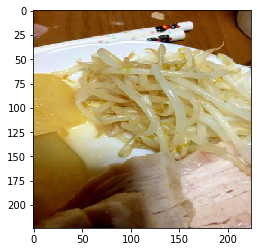

[  1  13  16 139 276 327 339 347 437]
['塩', '片栗粉', '日本酒', '水菜', 'ペースト', '鱧', 'カマンベールチーズ', '梅', '生春巻きの皮']


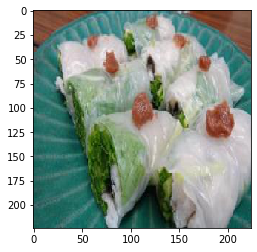

[ 10  24  28  38  69  77 291 382 502 507 616]
['マヨネーズ', 'こしょう', 'じゃがいも', 'トマト', 'パン粉', 'チーズ', 'パルメザンチーズ', '粗挽き黒こしょう', '種', '十勝', 'チェダーチーズ']


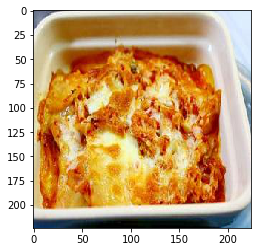

[  0   1   2   5   6   8  27  30  31  84 148 309 455]
['醤油', '塩', '酒', 'ゴマ油', 'オリーブオイル', 'ニンニク', '麺つゆ', 'ポン酢', 'レモン汁', 'もやし', '白子', '味付け', 'ブロッコリースプラウト']


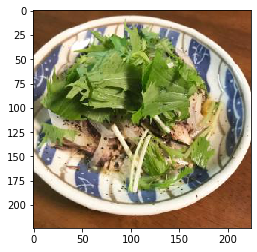

[ 11  12  17  47  49  75 211 366 696]
['玉ねぎ', '黒胡椒', 'バター', 'ケチャップ', 'ピザ用チーズ', '生ハム', 'ピザ生地', 'ピザ', 'キーマカレー']


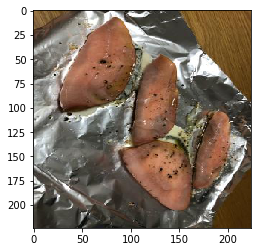

[ 0  1  6  7 17 29 36]
['醤油', '塩', 'オリーブオイル', '塩コショウ', 'バター', '大葉', '刺身']


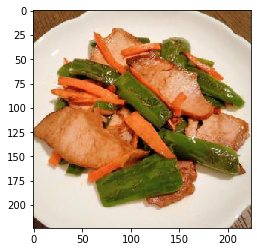

[ 0  1  5 14 28 32 93]
['醤油', '塩', 'ゴマ油', 'サラダ油', 'じゃがいも', 'わさび', 'レンコン']


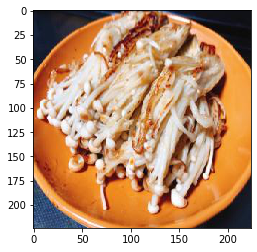

[  0   1   6   8  10  11  12  19  22  31  37  38  45  56  80 111]
['醤油', '塩', 'オリーブオイル', 'ニンニク', 'マヨネーズ', '玉ねぎ', '黒胡椒', 'キュウリ', 'にんじん', 'レモン汁', 'オリーブ油', 'トマト', '鷹の爪', '牛乳', '牡蠣', 'ミニトマト']


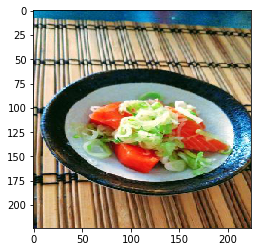

[  0   1  21  27  64  79  99 114]
['醤油', '塩', '大根', '麺つゆ', '油揚げ', '白菜', '白だし', '梅干し']


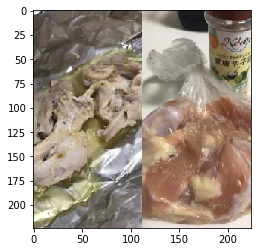

[  0   1   5  20  37 129 211]
['醤油', '塩', 'ゴマ油', '味噌', 'オリーブ油', '鯵', 'ピザ生地']


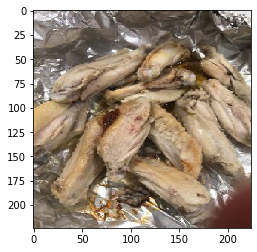

[  0   1   9  21  99 114 211]
['醤油', '塩', 'ねぎ', '大根', '白だし', '梅干し', 'ピザ生地']


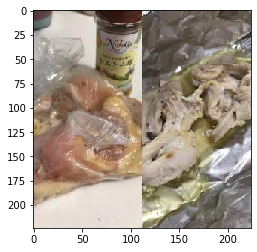

[  0   1   6   7  13  17  25  35  40  48  88 110 122 123]
['醤油', '塩', 'オリーブオイル', '塩コショウ', '片栗粉', 'バター', '小麦粉', 'パセリ', 'チューブニンニク', '白ワイン', '鶏もも肉', 'エリンギ', 'マッシュルーム', 'マジックソルト']


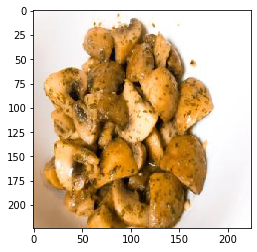

[  0   1   3  12  13  15  26  85 106 150 156]
['醤油', '塩', '砂糖', '黒胡椒', '片栗粉', '生姜', '揚げ油', 'ごぼう', '薄力粉', '天ぷら粉', '鶏胸肉']


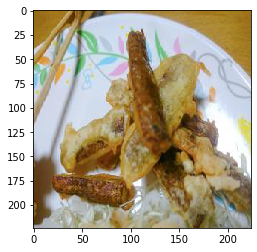

[  0   1  10  19  43  75 221 323 389 433 628]
['醤油', '塩', 'マヨネーズ', 'キュウリ', 'ベーコン', '生ハム', 'バゲット', 'ドレッシング', 'さつまいも', 'カボチャ', 'ミニ']


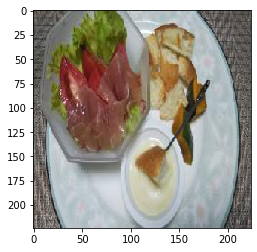

[  1   5  19  27  36  51 249]
['塩', 'ゴマ油', 'キュウリ', '麺つゆ', '刺身', '白ごま', 'オクラ']


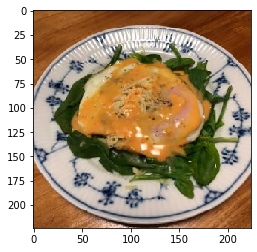

[  1   3   6   7  12  43  56 106 178 241 307 335 569]
['塩', '砂糖', 'オリーブオイル', '塩コショウ', '黒胡椒', 'ベーコン', '牛乳', '薄力粉', '強力粉', '無塩バター', 'コーン', 'インスタントドライイースト', 'フィリング']


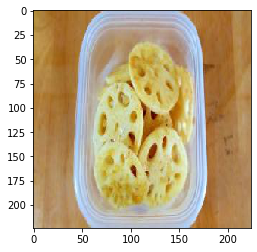

[  0   1   5   6  17  24  38  40  82 123]
['醤油', '塩', 'ゴマ油', 'オリーブオイル', 'バター', 'こしょう', 'トマト', 'チューブニンニク', 'タコ', 'マジックソルト']


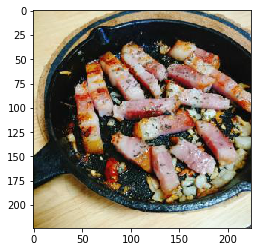

[  1   6   7  12  17 295]
['塩', 'オリーブオイル', '塩コショウ', '黒胡椒', 'バター', '魚肉ソーセージ']


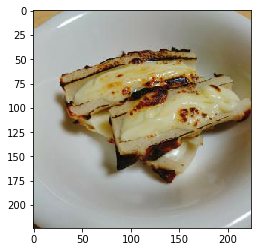

[   0    3   82  552 1279]
['醤油', '砂糖', 'タコ', '酒盗', 'スライスアーモンド']


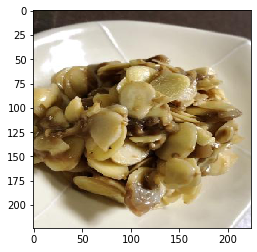

[ 0  1  2  3  4  7 11 12 17 27]
['醤油', '塩', '酒', '砂糖', 'みりん', '塩コショウ', '玉ねぎ', '黒胡椒', 'バター', '麺つゆ']


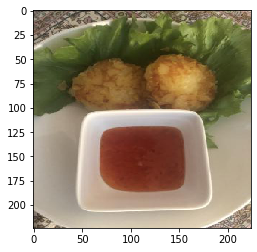

[ 0  1  2  3  4 13 14 18 26 34 59 88]
['醤油', '塩', '酒', '砂糖', 'みりん', '片栗粉', 'サラダ油', '卵', '揚げ油', '鰹節', 'おろし生姜', '鶏もも肉']


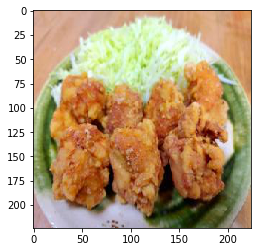

[   0    1    2    5    6   13   19   29   51  114  155  236  279  294
  296  338  757 1335]
['醤油', '塩', '酒', 'ゴマ油', 'オリーブオイル', '片栗粉', 'キュウリ', '大葉', '白ごま', '梅干し', '納豆', 'オリーブ', 'せり', '豆苗', 'イナダ', 'しらす', '炭酸水', '創味シャンタン']


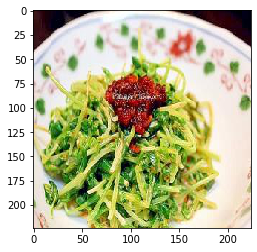

[  0   2   3   4   5  14  51  55  66  68 350]
['醤油', '酒', '砂糖', 'みりん', 'ゴマ油', 'サラダ油', '白ごま', 'ゴマ', '一味唐辛子', 'ナス', '水溶き片栗粉']


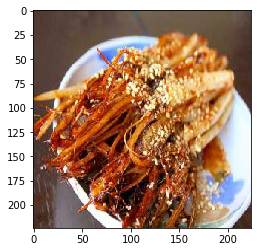

[ 1  6 14 39]
['塩', 'オリーブオイル', 'サラダ油', 'とろけるチーズ']


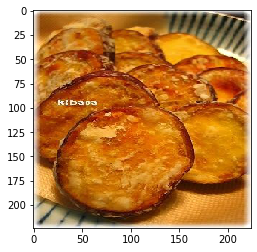

[ 0  1  3  6 12 45]
['醤油', '塩', '砂糖', 'オリーブオイル', '黒胡椒', '鷹の爪']


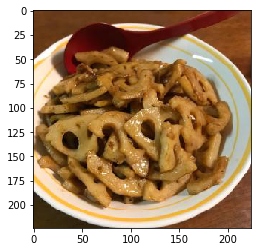

[ 1  3  5  9 22 37]
['塩', '砂糖', 'ゴマ油', 'ねぎ', 'にんじん', 'オリーブ油']


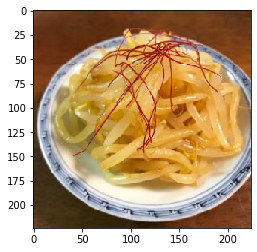

[ 0  1  2  3  4 21 55 76]
['醤油', '塩', '酒', '砂糖', 'みりん', '大根', 'ゴマ', '厚揚げ']


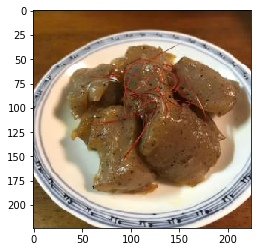

[  1   6   7   8  11  35  43  75 162 176 195]
['塩', 'オリーブオイル', '塩コショウ', 'ニンニク', '玉ねぎ', 'パセリ', 'ベーコン', '生ハム', 'バジル', 'ソーセージ', 'セロリ']


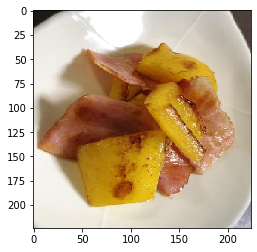

[  1   5   6   8  12  38  40  57 122 123]
['塩', 'ゴマ油', 'オリーブオイル', 'ニンニク', '黒胡椒', 'トマト', 'チューブニンニク', 'シイタケ', 'マッシュルーム', 'マジックソルト']


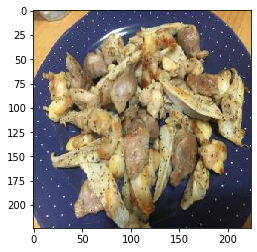

[  1   6   7   8  24  28  30  38  40  82 232 483]
['塩', 'オリーブオイル', '塩コショウ', 'ニンニク', 'こしょう', 'じゃがいも', 'ポン酢', 'トマト', 'チューブニンニク', 'タコ', 'ローズマリー', 'ぶなしめじ']


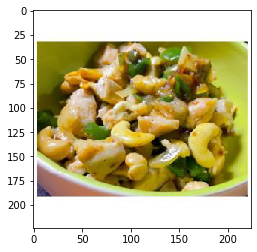

[  1   3   6  19  22  23  50  96 182 343]
['塩', '砂糖', 'オリーブオイル', 'キュウリ', 'にんじん', '酢', 'おろしにんにく', '和風だし', '茗荷', 'ミツカン']


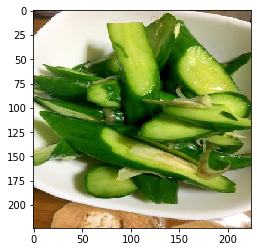

[ 1  6 25 77]
['塩', 'オリーブオイル', '小麦粉', 'チーズ']


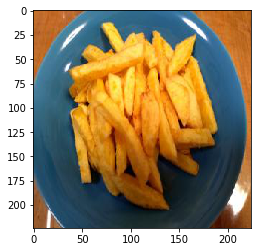

[  0   5   7   8  17  19  52 171 251]
['醤油', 'ゴマ油', '塩コショウ', 'ニンニク', 'バター', 'キュウリ', 'ピーマン', '小松菜', 'ししとう']


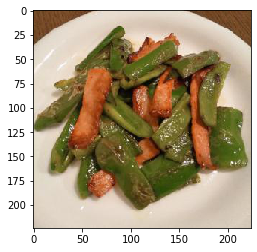

[ 0  1  3  5  8 10 12 15 21]
['醤油', '塩', '砂糖', 'ゴマ油', 'ニンニク', 'マヨネーズ', '黒胡椒', '生姜', '大根']


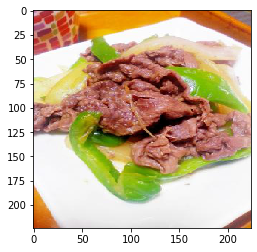

[  0   1  24  31  32  36  53  78 252]
['醤油', '塩', 'こしょう', 'レモン汁', 'わさび', '刺身', '薄口醤油', '砂肝', '小ねぎ']


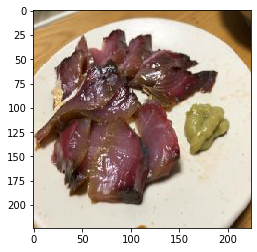

[  1  14  25  32 159]
['塩', 'サラダ油', '小麦粉', 'わさび', 'だし']


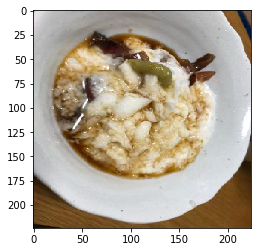

[  0   1   7  10  11  14  27  28  54 174]
['醤油', '塩', '塩コショウ', 'マヨネーズ', '玉ねぎ', 'サラダ油', '麺つゆ', 'じゃがいも', 'キャベツ', '新玉ねぎ']


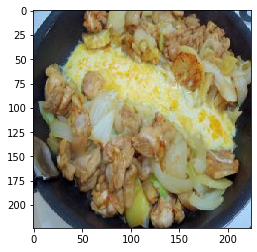

[  0   1   2   5   7  13  14  17  18  25  69 172 185]
['醤油', '塩', '酒', 'ゴマ油', '塩コショウ', '片栗粉', 'サラダ油', 'バター', '卵', '小麦粉', 'パン粉', '手羽先', '鰯']


KeyboardInterrupt: ignored

In [31]:
for i, pred in enumerate(preds):
    indexes = np.where(pred > 0.1)[0]
    print(indexes)
    pred_words = []
    for idx in indexes:
        pred_words.append(train_tokenizer.index_word[idx+1])
    print(pred_words)
    plt.imshow(x_test[i]/255.)
    plt.show()

In [0]:
# vocab_size = len(tokenizer.word_index) + 1
# caption_len = len(y_train[0])

# K.clear_session()

# # VGG
# encoder_input = Input(shape=(224, 224, 3))
# encoder_input_normalized = Lambda(lambda x: x / 255.)(encoder_input) # [0, 255) -> [0, 1)
# encoder = VGG16(weights='imagenet', include_top=False, input_tensor=encoder_input_normalized)

# # パラメータを固定
# for layer in encoder.layers:
#     layer.trainable = False

# # CNNの出力
# u = Flatten()(encoder.output)

# vgg_model = Model(encoder_input, u)

# # VGGから特徴量を抽出
# x_train_features = []
# x_test_features = []

# for x in tqdm(x_train):
#     x_features = vgg_model.predict(x[np.newaxis]).flatten()
#     x_train_features.append(x_features)

# for x in tqdm(x_test):
#     x_features = vgg_model.predict(x[np.newaxis]).flatten()
#     x_test_features.append(x_features)

# x_train_features = np.stack(x_train_features, axis=0)
# x_test_features = np.stack(x_test_features, axis=0)

# # 特徴量を保存
# np.save('/root/userspace/private/lesson5/data/x_train_features', x_train_features)
# np.save('/root/userspace/private/lesson5/data/x_test_features', x_test_features)